# Housing Price in Scotland
by Alif Sussardi

#### IBM Capstone Project of The Battle of Neighborhood

## A.1. Background

Scotland is one of the least populated area in the UK. With land area comprises of 32% of the total area in the UK, but only contributes to only 8.2 total population.[1] The most populated cities: Glasgow and Edinburgh are beautiful with large population of immigrants. As a resident of Edinburgh, where the rent is increasing every year, it is makes sense for me to understand how housing price is determined. 

Edinburgh is very touristy area, where many hotels and eating place always available nearby. Glasgow on the other hand, is relying on commerce. There are other places such as Aberdeen and Dundee which is more industrial where people do economic activities. In contrast, Highland or Orkney Island is rural place where the population density is lower. 

There are many factors that can determine housing price other than its amenities, such as location, what available nearby, and possibly the population density in the area. The question would be whether the housing price in Scotland is related to the population density and what available nearby, and what characteristics in each County. 

Moreover, it is important for an investor to know which place is the best for investing in a particular business such as buying property, opening Coffe Shop or Pub.

## A.2. Data Description


To answer the question and solve the problems, we can list data as below:
- Scotland House Price of October 2020 is available from Register of Scotland (ROS) website[2]. This data contains Local Authority Code, Local Authority Name and The Average Price, as well as Total Value and Number of Transactions. 

- The previous year price (2019) is also used as a comparison to the most recent data[3].

- The coordinate of each county is approximated using geolocator based on its Local Authority Name. This goespatial coordinate then will be used to find venues available in each County/Local Authority.

- The Scotland geospatial JSON is also collected from a github my martinjc [4] to be utilised to graph choropleth map according to data that has been processed.

- To know whether the population density affecting the price, land area data [5] and population data [6] are collected from ROS and Office of National Statistics (ONS) website. 

Venue data obtained from Foursquare, Population Density, etc will be compared with the Average Housing Price. The venue data will also be used to see whether the county can be clustered accordingly and whether there is a relation between the cluster and the Housing Price. 


## References

[1] https://en.wikipedia.org/wiki/Demography_of_Scotland
[3] https://www.ros.gov.uk/__data/assets/excel_doc/0010/173575/RoS_monthly-house-price-statistics_tables_Oct-2020.xlsx

[3] https://www.ros.gov.uk/__data/assets/excel_doc/0007/171385/RoS_quarterly-house-price-statistics_tables_2020-21-Q2_July-to-September-2020.xlsx

[4] https://github.com/martinjc/UK-GeoJSON/raw/master/json/administrative/sco/lad.json

[5] https://www.ros.gov.uk/__data/assets/excel_doc/0016/162016/property-market-report-2019-2020.xlsx

[6] https://www.ons.gov.uk/file?uri=%2fpeoplepopulationandcommunity%2fpopulationandmigration%2fpopulationestimates%2fdatasets%2fpopulationestimatesforukenglandandwalesscotlandandnorthernireland%2fmid2019april2020localauthoritydistrictcodes/ukmidyearestimates20192020ladcodes.xls

# Data Processing

## First of all, lets import all relevant packages and libraries

In [2]:
#Pandas for dataframe analysis
import pandas as pd # library for data analsysis
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

# tranform JSON file into a pandas dataframe
from pandas.io.json import json_normalize 

#Numpy for array operations
import numpy as np 

#json for handling with json data
import json 

# convert address into coordinate values
from geopy.geocoders import Nominatim
import geocoder

# library to handle requests
import requests 

# Matplotlib and associated plotting modules
import matplotlib.cm as cm
import matplotlib.colors as colors

# KMeans from sklearn for clustering
from sklearn.cluster import KMeans

# to render map
import folium 

#beautiful soup library for importing html format
#!pip install beautifulsoup4    #to install bs4 package
from bs4 import BeautifulSoup

#package to process html and xml
import lxml

# matplotlib
import matplotlib.pyplot as plt
import seaborn as sns

print('Libraries imported.')

Libraries imported.


## Download relevant data

### Relevant data Including: 
 - Scotland house price database of October 2020
 - Scotland house price 2019
 - Scotland Geospatial JSON
 - Scotland Land Areas
 - Scotland Population

In [3]:
# Scotland house price database 2020
# !wget -O scotland_house_price.xlsx https://www.ros.gov.uk/__data/assets/excel_doc/0010/173575/RoS_monthly-house-price-statistics_tables_Oct-2020.xlsx

#Scotland house price 2019
# !wget -O quarterly.xlsx https://www.ros.gov.uk/__data/assets/excel_doc/0007/171385/RoS_quarterly-house-price-statistics_tables_2020-21-Q2_July-to-September-2020.xlsx

# Scotland geojson
# !wget -O scotland.json https://github.com/martinjc/UK-GeoJSON/raw/master/json/administrative/sco/lad.json

# Scotland land area
# !wget -O scotland_area.xlsx https://www.ros.gov.uk/__data/assets/excel_doc/0016/162016/property-market-report-2019-2020.xlsx

# Scotland Population
# !wget -O population.xls https://www.ons.gov.uk/file?uri=%2fpeoplepopulationandcommunity%2fpopulationandmigration%2fpopulationestimates%2fdatasets%2fpopulationestimatesforukenglandandwalesscotlandandnorthernireland%2fmid2019april2020localauthoritydistrictcodes/ukmidyearestimates20192020ladcodes.xls

## Lets Create scot_a dataframe

### The scot_a dataframe contains Urban Areas, Rural Areas and Total Area of a County by its Local Authority Code

#### The scotland_area.xlsx contains large number of sheets with "Table 48" containing the important information about the land area of scotland by its County/Local Authority Name.

In [4]:
scot_a = pd.read_excel("scotland_area.xlsx", sheet_name = "Table 48", header = 7, usecols = "A:E", nrows = 33, index_col = 0)
scot_a.dropna(axis = 0, inplace=True)
scot_a.columns = ["LocalAuthority", "UrbanAreas", "RuralAreas", "TotalArea"]
scot_a = scot_a[["UrbanAreas", "RuralAreas", "TotalArea"]]
scot_a.head()

,UrbanAreas,RuralAreas,TotalArea
Local authority code,,,
S12000033,8478.177586,10092.451054,18570.628640
S12000034,5770.833679,625490.050889,631260.884568
S12000041,3000.761652,215177.785564,218178.547216
S12000035,2312.039540,688634.581138,690946.620678
S12000036,13343.762443,12989.628748,26333.391191


## Create scot_hp : House Price dataframe

### This dataframe contains the housing price: Average Price, Sales Volume and Total Volume by its Local Authority

#### Read from scotland_house_price.xlsx, this excel file contains large number of sheets and the most important information is in its Summary sheet. The latitude and longitude columns were added for assignment in the next step.

In [5]:
scot_hp = pd.read_excel("scotland_house_price.xlsx", sheet_name = "Summary", header = 7, usecols = "C:G", nrows = 33, index_col = 0)
scot_hp.dropna(axis = 0, inplace=True)
scot_hp.columns = ["LocalAuthority", "AveragePrice", "SalesVolume", "TotalValue"]
scot_hp['latitude'] = ""
scot_hp['longitude'] = ""
scot_hp.head()

,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude
Local authority code,,,,,,
S12000033,Aberdeen City,185268.611241,427.0,79109697.0,,
S12000034,Aberdeenshire,216034.723282,524.0,113202195.0,,
S12000041,Angus,181711.374501,251.0,45609555.0,,
S12000035,Argyll and Bute,180471.890688,247.0,44576557.0,,
S12000036,City of Edinburgh,296394.368824,1174.0,347966989.0,,


## Housing Price of 2019 addition

#### Housing PRice of 2019 was added as a comparison, as this time, the price was not affected much by COVID-19 pandemic.

In [6]:
scot_hp19 = pd.read_excel("quarterly.xlsx", sheet_name = "Table 1_average price", header = 7, usecols = "A:D", nrows = 2317, index_col = None)
scot_hp19 = scot_hp19[scot_hp19['Date']=='2019-20 Q2']
scot_hp19 = scot_hp19[scot_hp19['Local authority code'].str.contains("S120")]
scot_hp19.drop(columns=['Date','Local authority'], inplace=True)
scot_hp19.columns = ['LocalAuthorityCode', 'AveragePrice19']
scot_hp19.set_index('LocalAuthorityCode', inplace=True)

In [7]:
scot_hp = scot_hp.merge(scot_hp19, left_index=True, right_index=True)
scot_hp.head()

,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19
S12000033,Aberdeen City,185268.611241,427.0,79109697.0,,,193722
S12000034,Aberdeenshire,216034.723282,524.0,113202195.0,,,215922
S12000041,Angus,181711.374501,251.0,45609555.0,,,171809
S12000035,Argyll and Bute,180471.890688,247.0,44576557.0,,,172582
S12000036,City of Edinburgh,296394.368824,1174.0,347966989.0,,,274168


## Geospatial coordinate addition

### To add geospatial coordinates (latitude & longitude) into the scot_df dataframe, I was using geolocator, by assigning the latitude and longitude based on its LocalAuthority name

#### Declare the latitude & longitude for plotting later

In [8]:
address = 'Midlothian, Scotland '

geolocator = Nominatim(user_agent="toronto_explorer")
location = geolocator.geocode(address)

#declare latitude ang longitude of Toronto
latitude = location.latitude
longitude = location.longitude

print('The geograpical coordinate of City of Edinburgh are {}, {}.'.format(latitude, longitude))

The geograpical coordinate of City of Edinburgh are 55.833333, -3.083333.


#### This is the code to fill latitude & longitude columns in scot_df with their actual values.

In [9]:
for i, place in enumerate(scot_hp['LocalAuthority']):
    address = str(place + ", Scotland, United Kingdom")
    geolocator = Nominatim(user_agent="tartan_explorer")
    location = geolocator.geocode(address)
    scot_hp.iloc[i,4] = location.latitude
    scot_hp.iloc[i,5] = location.longitude

scot_hp.head()

,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19
S12000033,Aberdeen City,185268.611241,427.0,79109697.0,57.1482,-2.09281,193722
S12000034,Aberdeenshire,216034.723282,524.0,113202195.0,57.1667,-2.66667,215922
S12000041,Angus,181711.374501,251.0,45609555.0,56.6667,-2.91667,171809
S12000035,Argyll and Bute,180471.890688,247.0,44576557.0,56.4603,-5.86184,172582
S12000036,City of Edinburgh,296394.368824,1174.0,347966989.0,55.9533,-3.18837,274168


## Merge scot_a and scot_hp dataframes

### Now that latitude and longitude data has been filled, the land areas data can be added into the scot_df

In [10]:
scot_df = scot_hp.merge(scot_a, how="outer", left_index=True, right_index=True)
scot_df.head()

,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19,UrbanAreas,RuralAreas,TotalArea
S12000033,Aberdeen City,185268.611241,427.0,79109697.0,57.1482,-2.09281,193722,8478.177586,10092.451054,18570.628640
S12000034,Aberdeenshire,216034.723282,524.0,113202195.0,57.1667,-2.66667,215922,5770.833679,625490.050889,631260.884568
S12000041,Angus,181711.374501,251.0,45609555.0,56.6667,-2.91667,171809,3000.761652,215177.785564,218178.547216
S12000035,Argyll and Bute,180471.890688,247.0,44576557.0,56.4603,-5.86184,172582,2312.039540,688634.581138,690946.620678
S12000036,City of Edinburgh,296394.368824,1174.0,347966989.0,55.9533,-3.18837,274168,13343.762443,12989.628748,26333.391191


## Read and Load Population data

### The population data is important to obtain the Population Density data, it can be obtained from xls file from abovementioned source

In [11]:
uk_pop = pd.read_excel("population.xls", sheet_name = "MYE2 - Persons", header = 4, usecols= "A,D", nrows = 426, index_col = 0)
uk_pop.dropna(axis = 0, inplace=True)
uk_pop.columns = ['Population']
uk_pop.head()

,Population
Code,
K02000001,66796807
K03000001,64903140
K04000001,59439840
E92000001,56286961
E12000001,2669941


### Now add the population to the scot_df based on its Local Authority Code

In [12]:
scot_df = scot_df.merge(uk_pop, how="left", left_index=True, right_index=True)
scot_df.reset_index(inplace=True)
scot_df.head()

,index,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19,UrbanAreas,RuralAreas,TotalArea,Population
0,S12000033,Aberdeen City,185268.611241,427.0,79109697.0,57.1482,-2.09281,193722,8478.177586,10092.451054,18570.628640,228670
1,S12000034,Aberdeenshire,216034.723282,524.0,113202195.0,57.1667,-2.66667,215922,5770.833679,625490.050889,631260.884568,261210
2,S12000041,Angus,181711.374501,251.0,45609555.0,56.6667,-2.91667,171809,3000.761652,215177.785564,218178.547216,116200
3,S12000035,Argyll and Bute,180471.890688,247.0,44576557.0,56.4603,-5.86184,172582,2312.039540,688634.581138,690946.620678,85870
4,S12000036,City of Edinburgh,296394.368824,1174.0,347966989.0,55.9533,-3.18837,274168,13343.762443,12989.628748,26333.391191,524930


### Add Population density and Urban Density

### Assumption: It is assumed that most of the population live in the urban area, which makes it more important than the rural in this case

In [13]:
scot_df['PopDensity'] = scot_df["Population"] / scot_df['TotalArea']
scot_df['UrbanDensity'] = scot_df["Population"] / scot_df['UrbanAreas']
scot_df.head()

,index,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19,UrbanAreas,RuralAreas,TotalArea,Population,PopDensity,UrbanDensity
0,S12000033,Aberdeen City,185268.611241,427.0,79109697.0,57.1482,-2.09281,193722,8478.177586,10092.451054,18570.628640,228670,12.313530,26.971598
1,S12000034,Aberdeenshire,216034.723282,524.0,113202195.0,57.1667,-2.66667,215922,5770.833679,625490.050889,631260.884568,261210,0.413791,45.263824
2,S12000041,Angus,181711.374501,251.0,45609555.0,56.6667,-2.91667,171809,3000.761652,215177.785564,218178.547216,116200,0.532591,38.723502
3,S12000035,Argyll and Bute,180471.890688,247.0,44576557.0,56.4603,-5.86184,172582,2312.039540,688634.581138,690946.620678,85870,0.124279,37.140368
4,S12000036,City of Edinburgh,296394.368824,1174.0,347966989.0,55.9533,-3.18837,274168,13343.762443,12989.628748,26333.391191,524930,19.934007,39.338980


### Now lets see 10 counties which have the most expensive house price in 2020.

In [14]:
scot_df.sort_values(by = 'AveragePrice', ascending = False).head(10).iloc[:, np.r_[1:3,7]]

,LocalAuthority,AveragePrice,AveragePrice19
4,City of Edinburgh,296394.368824,274168
11,East Renfrewshire,281824.273109,252110
10,East Lothian,266748.522033,250339
9,East Dunbartonshire,240413.209821,257145
17,Midlothian,238929.269911,232223
29,Stirling,234040.123711,215420
23,Perth and Kinross,230593.168508,206531
1,Aberdeenshire,216034.723282,215922
25,Scottish Borders,210735.883817,176549
31,West Lothian,198647.078212,187740


## Lets Draw a Map showing Population Density by County

In [15]:
# DECLARE THE CENTER OF THE MAP
address = 'Perth and Kinross, Scotland '

geolocator = Nominatim(user_agent="toronto_explorer")
location = geolocator.geocode(address)

#declare latitude ang longitude of Toronto
latitude = location.latitude
longitude = location.longitude


scotgeo = 'scotland.json'
scot_map = folium.Map(location=[latitude, longitude], zoom_start=7)
scot_map.choropleth(
    geo_data=scotgeo,
    data=scot_df,
    columns=['index','PopDensity'],
    key_on='feature.properties.LAD13CD',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Population Density of Scotland (People per Hectares square)'
)

# add markers to map
for lat, lng, LA in zip(scot_df['latitude'], scot_df['longitude'], scot_df['LocalAuthority']):
    label = '{}'.format(LA)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.4,
        parse_html=False,
        fontsize = 14).add_to(scot_map)  
    
scot_map

C:\ProgramData\Anaconda3\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


### It can be seen that most population are concentrated at city, around Glasgow, Edinburgh, Dundee and Aberdeen

### Map based on its Average Housing Price

In [16]:
# DECLARE THE CENTER OF THE MAP
address = 'Perth and Kinross, Scotland '

geolocator = Nominatim(user_agent="toronto_explorer")
location = geolocator.geocode(address)

#declare latitude ang longitude of Toronto
latitude = location.latitude
longitude = location.longitude


scotgeo = 'scotland.json'
scot_map = folium.Map(location=[latitude, longitude], zoom_start=7)
scot_map.choropleth(
    geo_data=scotgeo,
    data=scot_df,
    columns=['index','AveragePrice'],
    key_on='feature.properties.LAD13CD',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='Average Housing Price (GBP)'
)

# add markers to map
for lat, lng, LA in zip(scot_df['latitude'], scot_df['longitude'], scot_df['LocalAuthority']):
    label = '{}'.format(LA)
    label = folium.Popup(label, parse_html=True)
    folium.CircleMarker(
        [lat, lng],
        radius=4,
        popup=label,
        color='blue',
        fill=True,
        fill_color='#3186cc',
        fill_opacity=0.4,
        parse_html=False,
        fontsize = 14).add_to(scot_map)  
    
scot_map

### It can be seen that two most expensive areas are Glasgow and Edinburgh. However, outside both city, the price seems quite random.

## Exploratory Analysis

## Looking at the Obvious

### 1. Lets begin with looking at Total Transaction vs Population, the obvious

C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\cbook\__init__.py:1402: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  ndim = x[:, None].ndim
C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:276: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  x = x[:, np.newaxis]
C:\ProgramData\Anaconda3\lib\site-packages\matplotlib\axes\_base.py:278: FutureWarning: Support for multi-dimensional indexing (e.g. `obj[:, None]`) is deprecated and will be removed in a future version.  Convert to a numpy array before indexing instead.
  y = y[:, np.newaxis]


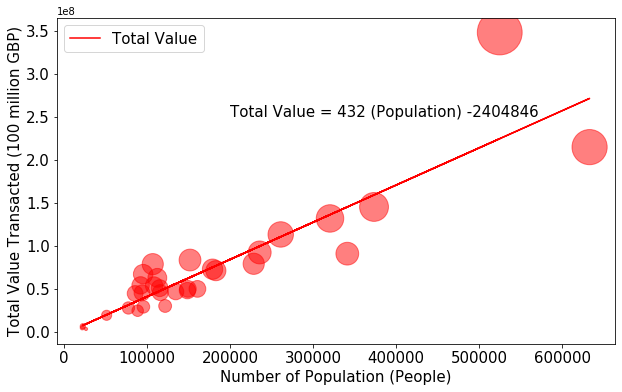

In [17]:
### type your answer here
norm_totalv = (scot_df['TotalValue'] - scot_df['TotalValue'].min()) / (scot_df['TotalValue'].max() - scot_df['TotalValue'].min())
x = scot_df['Population']      # year on x-axis
y = scot_df['TotalValue']     # total on y-axis
fit = np.polyfit(x, y, deg=1)


ax0 = scot_df.plot(kind='scatter',
                   x = 'Population',
                   y = 'TotalValue',
                   alpha = 0.5,
                   color = 'red',
                   s=norm_totalv*2000+10,
                   figsize = (10,6))

plt.plot(x, fit[0] * x + fit[1], color='red') # recall that x is the Years
plt.annotate('Total Value = {0:.0f} (Population) {1:.0f}'.format(fit[0], fit[1]), xy=(200000, 250000000), fontsize = 15)

ax0.set_ylabel('Total Value Transacted (100 million GBP)', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Number of Population (People)', fontsize = 15)
# ax0.set_xtickslabel(ax0.get_xtickslabel[0, "100k"], rotation=90)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
ax0.legend(['Total Value'], loc='upper left', fontsize = 15)

plt.show()

#### It is obvious that with increasing Population, the Value Transacted also increase. This could be a a sign that no matter where you are, Scottish people can afford to buy house.

### 2. Population vs Number of Sales

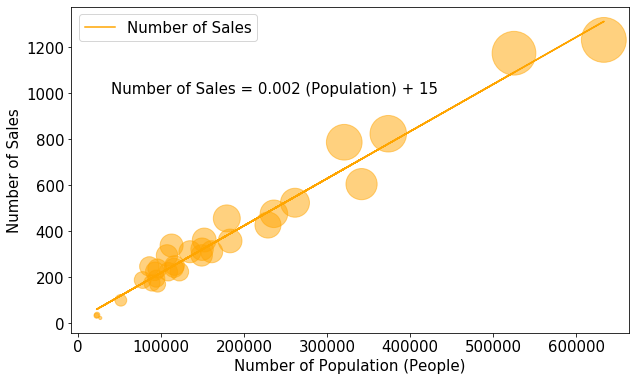

In [18]:
### type your answer here
norm_salesv = (scot_df['SalesVolume'] - scot_df['SalesVolume'].min()) / (scot_df['SalesVolume'].max() - scot_df['SalesVolume'].min())
x1= scot_df['Population']      # year on x-axis
y1 = scot_df['SalesVolume']     # total on y-axis
fit1 = np.polyfit(x1, y1, deg=1)


ax0 = scot_df.plot(kind='scatter',
                   x = 'Population',
                   y = 'SalesVolume',
                   alpha = 0.5,
                   color = 'orange',
                   s=norm_salesv*2000+10,
                   figsize = (10,6))

plt.plot(x, fit1[0] * x + fit1[1], color='orange') # recall that x is the Years
plt.annotate('Number of Sales = 0.002 (Population) + {1:.0f}'.format(fit1[0], fit1[1]), xy=(40000, 1000), fontsize = 15)

ax0.set_ylabel('Number of Sales', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Number of Population (People)', fontsize = 15)
# ax0.set_xtickslabel(ax0.get_xtickslabel[0, "100k"], rotation=90)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
ax0.legend(['Number of Sales'], loc='upper left', fontsize = 15)

plt.show()

## Not so obvious

### Population Density v. Average Price

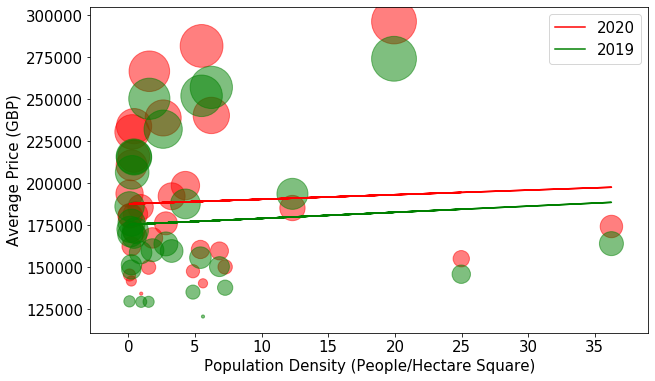

In [19]:
### type your answer here
norm_pricev = (scot_df['AveragePrice'] - scot_df['AveragePrice'].min()) / (scot_df['AveragePrice'].max() - scot_df['AveragePrice'].min())
norm_price19 = (scot_df['AveragePrice19'] - scot_df['AveragePrice19'].min()) / (scot_df['AveragePrice19'].max() - scot_df['AveragePrice19'].min())

x = scot_df['PopDensity']      # year on x-axis
y = scot_df['AveragePrice']     # total on y-axis
fit = np.polyfit(x, y, deg=1)

# x = scot_df['PopDensity']      # year on x-axis
y1 = scot_df['AveragePrice19'].astype(float)     # total on y-axis
fits = np.polyfit(x, y1, deg=1)




ax0 = scot_df.plot(kind='scatter',
                   x = 'PopDensity',
                   y = 'AveragePrice',
                   alpha = 0.5,
                   color = 'red',
                   s=norm_pricev*2000+10,
                   figsize = (10,6))

ax1 = scot_df.plot(kind='scatter',
                   x = 'PopDensity',
                   y = 'AveragePrice19',
                   alpha = 0.5,
                   color = 'green',
                   s=norm_price19.astype(float)*2000+10,
                   ax = ax0
                  )

plt.plot(x, fit[0] * x + fit[1], color='red') # recall that x is the Years
plt.plot(x, fits[0] * x + fits[1], color='green') # recall that x is the Years

# plt.annotate('Number of Sales = 0.002 (Population) + {1:.0f}'.format(fit1[0], fit1[1]), xy=(40000, 1000), fontsize = 15)
# plt.annotate('Number of Sales = 0.002 (Population) + {1:.0f}'.format(fit1[0], fit1[1]), xy=(40000, 1000), fontsize = 15)

ax0.set_ylabel('Average Price (GBP)', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Population Density (People/Hectare Square)', fontsize = 15)
# ax0.set_xtickslabel(ax0.get_xtickslabel[0, "100k"], rotation=90)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
ax0.legend(['2020','2019'], loc='upper right', fontsize = 15)

plt.show()

### It can be seen that the price is increased from 2019 to 2020

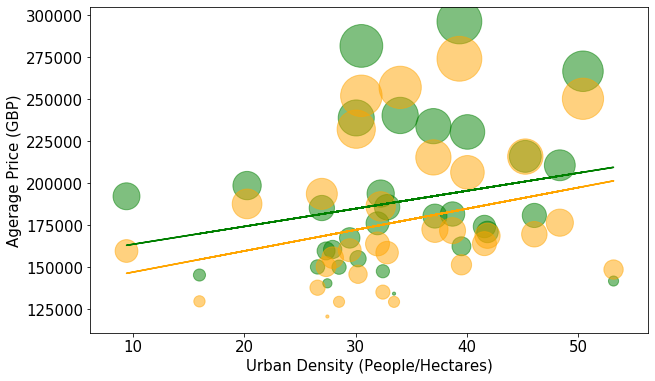

In [21]:
norm_urbanv = (scot_df['AveragePrice'] - scot_df['AveragePrice'].min()) / (scot_df['AveragePrice'].max() - scot_df['AveragePrice'].min())
norm_price19 = (scot_df['AveragePrice19'] - scot_df['AveragePrice19'].min()) / (scot_df['AveragePrice19'].max() - scot_df['AveragePrice19'].min())

x = scot_df['UrbanDensity']      # year on x-axis
y = scot_df['AveragePrice']  
y1 = scot_df['AveragePrice19'].astype(float) # total on y-axis
fit = np.polyfit(x, y, deg=1)
fit1 = np.polyfit(x, y1, deg=1)


ax0 = scot_df.plot(kind='scatter',
                   x = 'UrbanDensity',
                   y = 'AveragePrice',
                   alpha = 0.5,
                   color = 'green',
                   s=norm_pricev*2000+10,
                   figsize = (10,6))

ax1 = scot_df.plot(kind='scatter',
                   x = 'UrbanDensity',
                   y = 'AveragePrice19',
                   alpha = 0.5,
                   color = 'orange',
                   s=norm_price19.astype(float)*2000+10,
                   ax = ax0
                  )

plt.plot(x, fit[0] * x + fit[1], color='green') # recall that x is the Years
plt.plot(x, fit1[0] * x + fit1[1], color='orange') # recall that x is the Years
# plt.annotate('y={0:.0f} x + {1:.0f}'.format(fit[0], fit[1]), xy=(2000, 150000))

ax0.set_ylabel('Agerage Price (GBP)', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Urban Density (People/Hectares)', fontsize = 15)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
# ax0.legend(['Number of Sales'], loc='upper left', fontsize = 15)

plt.show()

## What about number of venues? is it affecting the Average Price?

### Import relevant function

In [22]:
def getNearbyVenues(names, latitudes, longitudes, radius=2500):
    
    venues_list=[]
    for name, lat, lng in zip(names, latitudes, longitudes):
        print(name)
            
        # create the API request URL
        url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
            CLIENT_ID, 
            CLIENT_SECRET, 
            VERSION, 
            lat, 
            lng, 
            radius, 
            1000)
            
        # make the GET request
        results = requests.get(url).json()["response"]['groups'][0]['items']
        
        # return only relevant information for each nearby venue
        venues_list.append([(
            name, 
            lat, 
            lng, 
            v['venue']['name'], 
            v['venue']['location']['lat'], 
            v['venue']['location']['lng'],  
            v['venue']['categories'][0]['name']) for v in results])

    nearby_venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
    nearby_venues.columns = ['LocalAuthority', 
                  'LocalAuth Latitude', 
                  'LocalAuth Longitude', 
                  'Venue', 
                  'Venue Latitude', 
                  'Venue Longitude', 
                  'Venue Category']
    
    return(nearby_venues)

In [23]:
# function that extracts the category of the venue
def get_category_type(row):
    try:
        categories_list = row['categories']
    except:
        categories_list = row['venue.categories']
        
    if len(categories_list) == 0:
        return None
    else:
        return categories_list[0]['name']

### Declare Foursquare Credentials

In [24]:
CLIENT_ID = 'J3CMVHKAWSEY0XERG4LZAXGQXF3JS3YZHUICIJNX3K3UYOD0' # your Foursquare ID
CLIENT_SECRET = 'I2K5FYQT1NJTHBZP4XKWUY4OYTXMS02S4ODUUJVTBQ3KBRNA' # your Foursquare Secret
ACCESS_TOKEN = '4ALZXGOA4IKH5AZXI44FDFITI3JKEWLADWE34HCI3LL4KGI3' # your FourSquare Access Token
VERSION = '20180605' # Foursquare API version
LIMIT = 100 # A default Foursquare API limit value

print('Your credentails:')
print('CLIENT_ID: ' + CLIENT_ID)
print('CLIENT_SECRET:' + CLIENT_SECRET)

Your credentails:
CLIENT_ID: J3CMVHKAWSEY0XERG4LZAXGQXF3JS3YZHUICIJNX3K3UYOD0
CLIENT_SECRET:I2K5FYQT1NJTHBZP4XKWUY4OYTXMS02S4ODUUJVTBQ3KBRNA


### Try to connect to Foursquare using Forsquare API

In [25]:
LIMIT = 1000 # limit of number of venues returned by Foursquare API
radius = 2500 # define radius
url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
    CLIENT_ID, 
    CLIENT_SECRET, 
    VERSION, 
    scot_df.loc[0, 'latitude'], 
    scot_df.loc[0, 'latitude'], 
    radius, 
    LIMIT)
url # display URL

'https://api.foursquare.com/v2/venues/explore?&client_id=J3CMVHKAWSEY0XERG4LZAXGQXF3JS3YZHUICIJNX3K3UYOD0&client_secret=I2K5FYQT1NJTHBZP4XKWUY4OYTXMS02S4ODUUJVTBQ3KBRNA&v=20180605&ll=57.1482429,57.1482429&radius=2500&limit=1000'

### Try to get nearby venue from the scot_df

In [26]:
scot_venues = getNearbyVenues(names=scot_df['LocalAuthority'],
                                   latitudes=scot_df['latitude'],
                                   longitudes=scot_df['longitude']
                                  )

Aberdeen City
Aberdeenshire
Angus
Argyll and Bute
City of Edinburgh
Clackmannanshire
Dumfries and Galloway
Dundee City
East Ayrshire
East Dunbartonshire
East Lothian
East Renfrewshire
Falkirk
Fife
Glasgow City
Highland
Inverclyde
Midlothian
Moray
Na h-Eileanan Siar
North Ayrshire
North Lanarkshire
Orkney Islands
Perth and Kinross
Renfrewshire
Scottish Borders
Shetland Islands
South Ayrshire
South Lanarkshire
Stirling
West Dunbartonshire
West Lothian


### Not let see the venue shape and 5 first rows of the scot_venues dataframe

In [27]:
print(scot_venues.shape)
scot_venues.head()

(600, 7)


,LocalAuthority,LocalAuth Latitude,LocalAuth Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
0,Aberdeen City,57.148243,-2.092809,BrewDog Castlegate,57.147731,-2.094548,Beer Bar
1,Aberdeen City,57.148243,-2.092809,BrewDog Aberdeen,57.149520,-2.097525,Beer Bar
2,Aberdeen City,57.148243,-2.092809,Six Degrees North,57.149971,-2.096750,Bar
3,Aberdeen City,57.148243,-2.092809,Fierce Bar Aberdeen,57.147389,-2.094415,Beer Bar
4,Aberdeen City,57.148243,-2.092809,CASC ABERDEEN,57.145874,-2.097568,Bar


### Lets count the number of venue that each local authority has

In [28]:
scot_venues.groupby('LocalAuthority').count()

,LocalAuth Latitude,LocalAuth Longitude,Venue,Venue Latitude,Venue Longitude,Venue Category
LocalAuthority,,,,,,
Aberdeen City,70,70,70,70,70,70
Aberdeenshire,1,1,1,1,1,1
Angus,3,3,3,3,3,3
City of Edinburgh,100,100,100,100,100,100
Clackmannanshire,9,9,9,9,9,9
Dumfries and Galloway,1,1,1,1,1,1
Dundee City,100,100,100,100,100,100
East Dunbartonshire,13,13,13,13,13,13
East Lothian,4,4,4,4,4,4


### Convert the counted venues into a dataframe: scot_venues_sort

In [29]:
scot_venues_sort = scot_venues.groupby('LocalAuthority').count().sort_values(by = 'LocalAuth Latitude', ascending = False).iloc[:,0].to_frame()
scot_venues_sort.columns = ['VenueCounts']
scot_venues_sort.reset_index(inplace=True)
scot_venues_sort

,LocalAuthority,VenueCounts
0,Glasgow City,100
1,Dundee City,100
2,City of Edinburgh,100
3,Falkirk,71
4,Aberdeen City,70
5,Stirling,47
6,Renfrewshire,22
7,East Dunbartonshire,13
8,Fife,11
9,West Lothian,9


#### We can see that Glasgow City, Dundee City and City of Edinburgh maxed out their venue counts.

### Lets see how each county compare in their Number of Venues

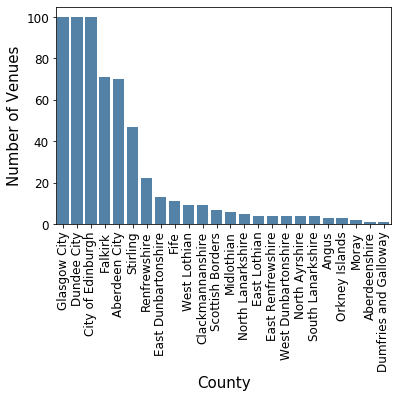

In [30]:
bared = sns.barplot(data=scot_venues_sort, x = 'LocalAuthority', y = 'VenueCounts', color = 'steelblue')
bared.set_xticklabels(bared.get_xticklabels(), rotation=90, fontsize = 12)
bared.set_yticklabels([0,20,40,60,80,100], fontsize = 12)
bared.set_ylabel('Number of Venues',fontsize = 15)
bared.set_xlabel('County',fontsize = 15)

plt.show()

### Lets find out how many unique venues available

In [31]:
print('There are {} uniques categories.'.format(len(scot_venues['Venue Category'].unique())))

There are 158 uniques categories.


### Lets convert all venues as Columns

In [32]:
# one hot encoding
scot_onehot = pd.get_dummies(scot_venues[['Venue Category']], prefix="", prefix_sep="")

# add neighborhood column back to dataframe
scot_onehot['LocalAuthority'] = scot_venues['LocalAuthority'] 

# move neighborhood column to the first column
fixed_columns = [scot_onehot.columns[-1]] + list(scot_onehot.columns[:-1])
scot_onehot = scot_onehot[fixed_columns]

print(scot_onehot.shape)

(600, 159)


### Lets group all the Venues by Local Authority and assign their mean values

In [33]:
scot_grouped = scot_onehot.groupby('LocalAuthority').mean().reset_index()
scot_grouped.head()

,LocalAuthority,Afghan Restaurant,American Restaurant,Art Gallery,Art Museum,Arts & Crafts Store,Asian Restaurant,Athletics & Sports,Auto Garage,BBQ Joint,Bakery,Bar,Basketball Court,Beach,Bed & Breakfast,Beer Bar,Beer Garden,Bike Shop,Bistro,Bookstore,Bowling Alley,Brazilian Restaurant,Breakfast Spot,Brewery,Burger Joint,Bus Station,Café,Canal Lock,Casino,Castle,Cheese Shop,Chinese Restaurant,Church,Clothing Store,Cocktail Bar,Coffee Shop,College Gym,Concert Hall,Construction & Landscaping,Convenience Store,Cosmetics Shop,Dance Studio,Deli / Bodega,Department Store,Dessert Shop,Diner,Discount Store,Dive Bar,Dog Run,Donut Shop,Electronics Store,English Restaurant,Event Space,Farm,Fast Food Restaurant,Fish & Chips Shop,Flea Market,French Restaurant,Furniture / Home Store,Garden,Garden Center,Gas Station,Gastropub,Gay Bar,German Restaurant,Gift Shop,Golf Course,Gourmet Shop,Greek Restaurant,Grocery Store,Gym,Gym / Fitness Center,Hardware Store,Hill,Historic Site,History Museum,Home Service,Hostel,Hotel,Ice Cream Shop,Indian Restaurant,Indie Movie Theater,Indoor Play Area,Irish Pub,Italian Restaurant,Japanese Restaurant,Juice Bar,Kebab Restaurant,Laundry Service,Liquor Store,Mediterranean Restaurant,Mexican Restaurant,Modern European Restaurant,Monument / Landmark,Mountain,Movie Theater,Multiplex,Museum,Music Store,Music Venue,Neighborhood,Nightclub,Noodle House,Outdoor Sculpture,Outlet Mall,Paella Restaurant,Palace,Park,Pedestrian Plaza,Performing Arts Venue,Pet Store,Pharmacy,Pizza Place,Plaza,Pool,Portuguese Restaurant,Pub,Record Shop,Rental Car Location,Rest Area,Restaurant,River,Road,Rugby Pitch,Russian Restaurant,Sandwich Place,Scenic Lookout,Science Museum,Scottish Restaurant,Sculpture Garden,Seafood Restaurant,Shopping Mall,Shopping Plaza,Skating Rink,Soccer Field,Soccer Stadium,South Indian Restaurant,Speakeasy,Sporting Goods Shop,Sports Bar,Stationery Store,Steakhouse,Student Center,Supermarket,Sushi Restaurant,Tailor Shop,Tapas Restaurant,Tea Room,Thai Restaurant,Theater,Toy / Game Store,Track Stadium,Trail,Train Station,Vegetarian / Vegan Restaurant,Video Game Store,Warehouse Store,Whisky Bar,Women's Store
0,Aberdeen City,0.0,0.00,0.00,0.00,0.000000,0.0,0.0,0.0,0.0,0.00,0.114286,0.0,0.014286,0.0,0.085714,0.0,0.0,0.00,0.014286,0.0,0.00,0.00,0.0,0.0,0.000000,0.100000,0.0,0.014286,0.00,0.0,0.0,0.00,0.000000,0.00,0.042857,0.0,0.00,0.0,0.014286,0.0,0.0,0.0,0.028571,0.0,0.0,0.000000,0.00,0.0,0.0,0.014286,0.00,0.0,0.0,0.0,0.0,0.000000,0.00,0.000000,0.00,0.0,0.0,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.042857,0.0,0.014286,0.0,0.00,0.00,0.0,0.0,0.014286,0.00,0.00,0.014286,0.014286,0.0,0.014286,0.028571,0.014286,0.00,0.0,0.0,0.00,0.0,0.014286,0.014286,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.000000,0.0,0.00,0.057143,0.0,0.014286,0.0,0.0,0.014286,0.00,0.0,0.0,0.028571,0.0,0.0,0.0,0.057143,0.014286,0.00,0.0,0.0,0.014286,0.014286,0.00,0.00,0.00,0.042857,0.014286,0.0,0.014286,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.028571,0.014286,0.0,0.0,0.014286,0.0,0.014286,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.014286,0.0
1,Aberdeenshire,0.0,0.00,0.00,0.00,0.000000,0.0,0.0,0.0,0.0,0.00,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.00,0.000000,0.0,0.00,0.00,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.00,0.0,0.0,0.00,0.000000,0.00,0.000000,0.0,0.00,0.0,0.000000,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.00,0.0,0.0,0.000000,0.00,0.0,0.0,0.0,0.0,0.000000,0.00,0.000000,0.00,0.0,0.0,0.00,0.00,0.0,0.00,0.0,0.0,0.0,0.000000,0.0,0.000000,0.0,0.00,0.00,0.0,1.0,0.000000,0.00,0.00,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.00,0.0,0.0,0.00,0.0,0.000000,0.000000,0.00,0.0,0.0,0.0,0.00,0.0,0.0,0.00,0.0,0.0,0.00,0.000000,0.0,0.00,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.00,0.0,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000,0.00,0.0,0.0,0.000000,0.000000,0.00,0.00,0.00,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.00,0.0,0.0,0.0,0.00,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.00,0.0,0.0,0.000000,0.0
2,Angus,0.0,0.00,0.00,0.00,0.333333,0.0,0.0,0.0

### Declare the function to return 5 most common venues

In [34]:
num_top_venues = 5
def return_most_common_venues(row, num_top_venues):
    row_categories = row.iloc[1:]
    row_categories_sorted = row_categories.sort_values(ascending=False)
    
    return row_categories_sorted.index.values[0:num_top_venues]

### Make columns containing 1st to 5th most common venues

In [35]:
# declare number of venues
num_top_venues = 5

indicators = ['st', 'nd', 'rd']

# create columns according to number of top venues
columns = ['LocalAuthority']
for ind in np.arange(num_top_venues):
    try:
        columns.append('{}{} Most Common Venue'.format(ind+1, indicators[ind]))
    except:
        columns.append('{}th Most Common Venue'.format(ind+1))

# create a new dataframe
neighborhoods_venues_sorted = pd.DataFrame(columns=columns)
neighborhoods_venues_sorted['LocalAuthority'] = scot_grouped['LocalAuthority']

for ind in np.arange(scot_grouped.shape[0]):
    neighborhoods_venues_sorted.iloc[ind, 1:] = return_most_common_venues(scot_grouped.iloc[ind, :], num_top_venues)

neighborhoods_venues_sorted.head()

,LocalAuthority,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Aberdeen City,Bar,Café,Beer Bar,Park,Restaurant
1,Aberdeenshire,Home Service,Women's Store,Electronics Store,French Restaurant,Flea Market
2,Angus,Flea Market,Arts & Crafts Store,Clothing Store,Women's Store,Electronics Store
3,City of Edinburgh,Hotel,Café,Bar,Cocktail Bar,Pub
4,Clackmannanshire,Furniture / Home Store,Bookstore,Discount Store,Bus Station,Café


### Lets find out what is the most common venues

In [36]:
first = neighborhoods_venues_sorted['1st Most Common Venue'].value_counts().to_frame()
second = neighborhoods_venues_sorted['2nd Most Common Venue'].value_counts().to_frame()
third = neighborhoods_venues_sorted['3rd Most Common Venue'].value_counts().to_frame()

onetothree = pd.merge(first, second, how = 'outer', left_index=True, right_index=True)
onetothree = pd.merge(onetothree, third, how = 'outer', left_index=True, right_index=True)
onetothree.fillna(0, inplace=True)
onethreesorted = onetothree.sort_values('1st Most Common Venue', ascending=False)

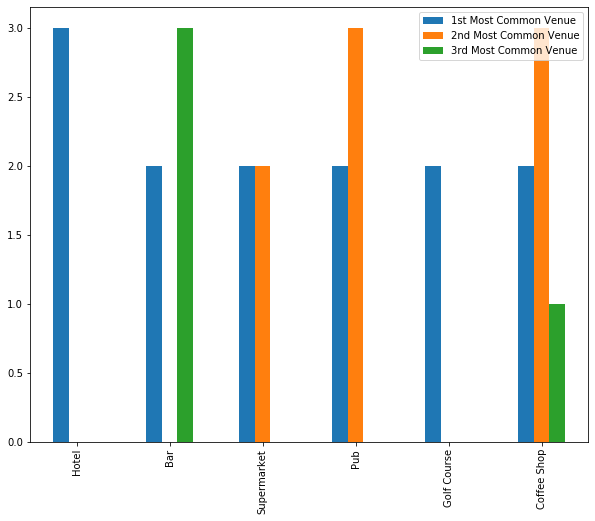

In [37]:
onethreesorted.head(6).plot(kind = 'bar', 
                           figsize = (10,8))
plt.show()

#### It can be seen that the most common venues are Hotel and drinking places either Pub, Bar or Coffee Shop

### To see whether the counties can be clustered based on venues, we need to cluster it with k-means, and find the best k value

### I chose k-means clustering as it is fast and realatively easy to operate

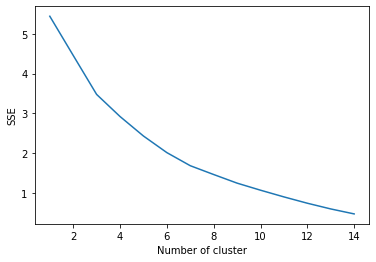

In [38]:
import pandas as pd
from sklearn.datasets import load_iris
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt

scot_grouped_clustering = scot_grouped.drop('LocalAuthority', 1)

sse = {}

for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(scot_grouped_clustering)
    scot_grouped_clustering["clusters"] = kmeans.labels_
    #print(data["clusters"])
    sse[k] = kmeans.inertia_ # Inertia: Sum of distances of samples to their closest cluster center
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")
plt.show()

### We can see that k = 3 show a change/discontinuity of the SSE plot. Therefore k = 3 is chosen. 

### Lets cluster the grouped venue with k=3 

In [39]:
# set number of clusters
kclusters = 3

# scotland_grouped_clustering = scotland_grouped.drop('LocalAuthority', 1)

# run k-means clustering
kmeans = KMeans(n_clusters=kclusters, random_state=0).fit(scot_grouped_clustering)

# check cluster labels generated for each row in the dataframe
kmeans.labels_[0:10]

array([0, 1, 1, 0, 0, 1, 0, 0, 2, 0])

#### Lets add the cluster number to the scot_merged dataframe 

In [40]:
# add clustering labels
neighborhoods_venues_sorted.insert(0, 'Cluster Labels', kmeans.labels_)

scot_merged = scot_df

# merge toronto_grouped with toronto_data to add latitude/longitude for each neighborhood
scot_merged = scot_merged.join(neighborhoods_venues_sorted.set_index('LocalAuthority'), on='LocalAuthority')
scot_merged.dropna(inplace=True)

# check the last columns!
scot_merged.head()

,index,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19,UrbanAreas,RuralAreas,TotalArea,Population,PopDensity,UrbanDensity,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,S12000033,Aberdeen City,185268.611241,427.0,7.910970e+07,57.1482,-2.09281,193722,8478.177586,10092.451054,18570.628640,228670,12.313530,26.971598,0.0,Bar,Café,Beer Bar,Park,Restaurant
1,S12000034,Aberdeenshire,216034.723282,524.0,1.132022e+08,57.1667,-2.66667,215922,5770.833679,625490.050889,631260.884568,261210,0.413791,45.263824,1.0,Home Service,Women's Store,Electronics Store,French Restaurant,Flea Market
2,S12000041,Angus,181711.374501,251.0,4.560956e+07,56.6667,-2.91667,171809,3000.761652,215177.785564,218178.547216,116200,0.532591,38.723502,1.0,Flea Market,Arts & Crafts Store,Clothing Store,Women's Store,Electronics Store
4,S12000036,City of Edinburgh,296394.368824,1174.0,3.479670e+08,55.9533,-3.18837,274168,13343.762443,12989.628748,26333.391191,524930,19.934007,39.338980,0.0,Hotel,Café,Bar,Cocktail Bar,Pub
5,S12000005,Clackmannanshire,192275.352900,100.0,1.922754e+07,56.1664,-3.7514,159676,5475.491721,10388.268386,15863.760107,51540,3.248914,9.412853,0.0,Furniture / Home Store,Bookstore,Discount Store,Bus Station,Café


In [41]:
scot_merged = scot_merged.join(scot_venues_sort.set_index('LocalAuthority'), on='LocalAuthority')
scot_merged.head()

,index,LocalAuthority,AveragePrice,SalesVolume,TotalValue,latitude,longitude,AveragePrice19,UrbanAreas,RuralAreas,TotalArea,Population,PopDensity,UrbanDensity,Cluster Labels,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue,VenueCounts
0,S12000033,Aberdeen City,185268.611241,427.0,7.910970e+07,57.1482,-2.09281,193722,8478.177586,10092.451054,18570.628640,228670,12.313530,26.971598,0.0,Bar,Café,Beer Bar,Park,Restaurant,70
1,S12000034,Aberdeenshire,216034.723282,524.0,1.132022e+08,57.1667,-2.66667,215922,5770.833679,625490.050889,631260.884568,261210,0.413791,45.263824,1.0,Home Service,Women's Store,Electronics Store,French Restaurant,Flea Market,1
2,S12000041,Angus,181711.374501,251.0,4.560956e+07,56.6667,-2.91667,171809,3000.761652,215177.785564,218178.547216,116200,0.532591,38.723502,1.0,Flea Market,Arts & Crafts Store,Clothing Store,Women's Store,Electronics Store,3
4,S12000036,City of Edinburgh,296394.368824,1174.0,3.479670e+08,55.9533,-3.18837,274168,13343.762443,12989.628748,26333.391191,524930,19.934007,39.338980,0.0,Hotel,Café,Bar,Cocktail Bar,Pub,100
5,S12000005,Clackmannanshire,192275.352900,100.0,1.922754e+07,56.1664,-3.7514,159676,5475.491721,10388.268386,15863.760107,51540,3.248914,9.412853,0.0,Furniture / Home Store,Bookstore,Discount Store,Bus Station,Café,9


### And lets wee whether there is an obvious cluster from the map

In [47]:

# create map
map_clusters = folium.Map(location=[latitude, longitude], zoom_start=7)
scot_df['UrbanPerc'] = scot_df['UrbanAreas'] / scot_df['TotalArea']*100

# set color scheme for the clusters
x = np.arange(kclusters)
ys = [i + x + (i*x)**2 for i in range(kclusters)]
colors_array = cm.rainbow(np.linspace(0, 1, len(ys)))
rainbow = [colors.rgb2hex(i) for i in colors_array]

map_clusters.choropleth(
    geo_data=scotgeo,
    data=scot_df,
    columns=['index','UrbanPerc'],
    key_on='feature.properties.LAD13CD',
    fill_color='YlOrRd', 
    fill_opacity=0.7, 
    line_opacity=0.2,
    legend_name='% Urban Areas (Urban/Total Areas)'
)

# add markers to the map
markers_colors = []
for lat, lon, LocalAuth, cluster in zip(scot_merged['latitude'], scot_merged['longitude'], scot_merged['LocalAuthority'], scot_merged['Cluster Labels']):
    label = folium.Popup(str(LocalAuth) + ', Scotland '+' Cluster ' + str(cluster), parse_html=True)
    folium.CircleMarker(
        [lat, lon],
        radius=5,
        popup=label,
        color=rainbow[int(cluster)-1],
        fill=True,
        fill_color=rainbow[int(cluster)-1],
        fill_opacity=0.7).add_to(map_clusters)
       
map_clusters

C:\ProgramData\Anaconda3\lib\site-packages\folium\folium.py:411: FutureWarning: The choropleth  method has been deprecated. Instead use the new Choropleth class, which has the same arguments. See the example notebook 'GeoJSON_and_choropleth' for how to do this.
  warnings.warn(


#### We can see that  region with rather touristy and densely populated are clustered in the cluster = 0
#### The rather rural residential areas is the cluster =1
#### and surrounding of touristy areas in = 2

### Lets see further the characteristics of each cluster

### The 0th cluster 
Contains amenities that support tourist

In [49]:
zero_cluster  = scot_merged.loc[scot_merged['Cluster Labels'] == 0, scot_merged.columns[[1] + list(range(2, scot_merged.shape[1]))]]
zero_cluster.iloc[:,14:19]

,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
0,Bar,Café,Beer Bar,Park,Restaurant
4,Hotel,Café,Bar,Cocktail Bar,Pub
5,Furniture / Home Store,Bookstore,Discount Store,Bus Station,Café
7,Bar,Coffee Shop,Café,Pub,Hotel
9,Discount Store,Warehouse Store,Shopping Plaza,Pharmacy,Fast Food Restaurant
11,Golf Course,Pub,Garden Center,Women's Store,Electronics Store
12,Coffee Shop,Park,Furniture / Home Store,Hotel,Supermarket
13,Supermarket,Fish & Chips Shop,Warehouse Store,Farm,Train Station
14,Pub,Coffee Shop,Bar,Italian Restaurant,Cocktail Bar
20,Soccer Field,Supermarket,Grocery Store,Laundry Service,Women's Store


### The 1st Cluster
The amenities are characteristics of Residential Area

In [50]:
first_cluster = scot_merged.loc[scot_merged['Cluster Labels'] == 1, scot_merged.columns[[1] + list(range(2, scot_merged.shape[1]))]]
first_cluster.iloc[:, 14:19]

,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
1,Home Service,Women's Store,Electronics Store,French Restaurant,Flea Market
2,Flea Market,Arts & Crafts Store,Clothing Store,Women's Store,Electronics Store
6,Art Museum,Women's Store,Electronics Store,French Restaurant,Flea Market
17,Pub,Train Station,Restaurant,River,Bed & Breakfast
18,Mountain,Trail,Women's Store,Electronics Store,French Restaurant


### 2nd Cluster
Characteristics of supporting area for the touristy areas

In [51]:
second_cluster = scot_merged.loc[scot_merged['Cluster Labels'] == 2, scot_merged.columns[[1] + list(range(2, scot_merged.shape[1]))]]
second_cluster.iloc[:,14:19]

,1st Most Common Venue,2nd Most Common Venue,3rd Most Common Venue,4th Most Common Venue,5th Most Common Venue
10,Golf Course,Pub,Beer Garden,Grocery Store,Women's Store
22,Historic Site,Scenic Lookout,Women's Store,Dog Run,Fish & Chips Shop
25,Café,Gourmet Shop,Mountain,Trail,Dog Run
28,Construction & Landscaping,Rest Area,Restaurant,Café,Donut Shop
30,Hotel,Pub,Coffee Shop,Grocery Store,Donut Shop


### The Housing Price based on cluster

In [52]:
no_cluster = [0,1,2]
price_average = [zero_cluster['AveragePrice'].mean(), first_cluster['AveragePrice'].mean(), second_cluster['AveragePrice'].mean()]
venue_average = [zero_cluster['VenueCounts'].mean(), first_cluster['VenueCounts'].mean(), second_cluster['VenueCounts'].mean()]
clust_price = pd.DataFrame({'clusterno': no_cluster, 'venues': venue_average, 'price': price_average})
# clust_price.set_index('clusterno')
clust_price.head()

,clusterno,venues,price
0,0,40.357143,196781.000146
1,1,2.600000,194037.918663
2,2,4.400000,185435.274774


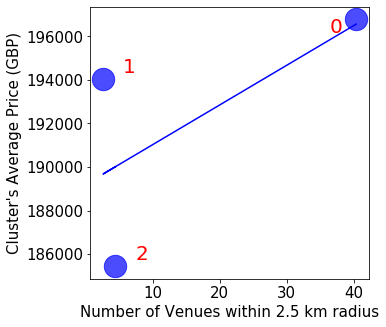

In [88]:
colour = ['red','green','blue']

### type your answer here
norm_pricev = (clust_price['price'] - clust_price['price'].min()) / (clust_price['price'].max() - clust_price['price'].min())
x = clust_price['venues']      # year on x-axis
y = clust_price['price']     # total on y-axis
fit = np.polyfit(x, y, deg=1)

ax0 = clust_price.plot(kind='scatter',
                       x = 'venues',
                       y = 'price',
                       alpha = 0.7,
                       color = colour[i],
                       s=500,
#                      s=norm_pricev*2000+100,
                       figsize = (5,5))

plt.plot(x, fit[0] * x + fit[1], color='blue') # recall that x is the Years
plt.annotate('0', xy=((clust_price.iloc[0,1]-4), (clust_price.iloc[0,2]-600)), fontsize = 20, color = "red")
plt.annotate('1', xy=((clust_price.iloc[1,1]+3), (clust_price.iloc[1,2]+300)), fontsize = 20, color = "red")
plt.annotate('2', xy=((clust_price.iloc[2,1]+3), (clust_price.iloc[2,2]+300)), fontsize = 20, color = "red")

ax0.set_ylabel("Cluster's Average Price (GBP)", fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Number of Venues within 2.5 km radius', fontsize = 15)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
# ax0.legend(['Number of Sales'], loc='upper left', fontsize = 20)

plt.show()

#### Surprisingly, the most expensive housing are at around Residential Areas with ~220000 GBP, secondly the touristy areas with ~190000 GBP and only ~170000 GBP at supporting area.

## BUT, Is number of venues affecting the Price? 

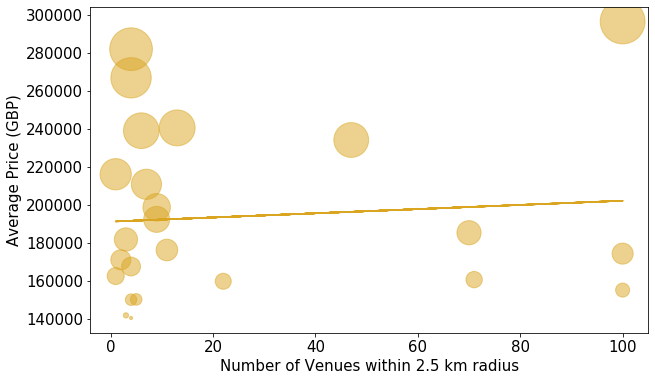

In [89]:
### type your answer here
norm_pricev = (scot_merged['AveragePrice'] - scot_merged['AveragePrice'].min()) / (scot_merged['AveragePrice'].max() - scot_merged['AveragePrice'].min())
x = scot_merged['VenueCounts']      # year on x-axis
y = scot_merged['AveragePrice']     # total on y-axis
fit = np.polyfit(x, y, deg=1)


ax0 = scot_merged.plot(kind='scatter',
                   x = 'VenueCounts',
                   y = 'AveragePrice',
                   alpha = 0.5,
                   color = 'goldenrod',
                   s=norm_pricev*2000+10,
                   figsize = (10,6))

plt.plot(x, fit[0] * x + fit[1], color='goldenrod') # recall that x is the Years
# plt.annotate('y={0:.0f} x + {1:.0f}'.format(fit[0], fit[1]), xy=(2000, 150000))

ax0.set_ylabel('Average Price (GBP)', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Number of Venues within 2.5 km radius', fontsize = 15)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
# ax0.legend(['Number of Sales'], loc='upper left', fontsize = 20)

plt.show()

## NO IT is not! Rather its region that affecting the price

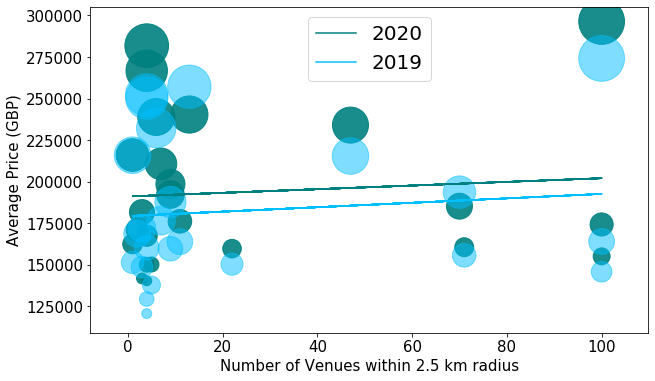

In [93]:

norm_pricev = (scot_merged['AveragePrice'] - scot_merged['AveragePrice'].min()) / (scot_merged['AveragePrice'].max() - scot_merged['AveragePrice'].min())
norm_pricev19 = (scot_merged['AveragePrice19'] - scot_merged['AveragePrice19'].min()) / (scot_merged['AveragePrice19'].max() - scot_merged['AveragePrice19'].min())

x = scot_merged['VenueCounts']      # year on x-axis
y = scot_merged['AveragePrice'].astype(float)     # total on y-axis
y1 = scot_merged['AveragePrice19'].astype(float)     # total on y-axis

fit = np.polyfit(x, y, deg=1)
fit1 = np.polyfit(x, y1, deg=1)


ax0 = scot_merged.plot(kind='scatter',
                   x = 'VenueCounts',
                   y = 'AveragePrice',
                   alpha = 0.9,
                   color = 'teal',
                   s=norm_pricev.astype(float)*2000+100,
                   figsize = (10,6))

ax1 = scot_merged.plot(kind='scatter',
                   x = 'VenueCounts',
                   y = 'AveragePrice19',
                   alpha = 0.5,
                   color = 'deepskyblue',
                   s=norm_pricev19.astype(float)*2000+100,
                   ax = ax0)

plt.plot(x, fit[0] * x + fit[1], color='teal') # recall that x is the Years
plt.plot(x, fit1[0] * x + fit1[1], color='deepskyblue') # recall that x is the Years

# plt.annotate('y={0:.0f} x + {1:.0f}'.format(fit[0], fit[1]), xy=(2000, 150000))

ax0.set_ylabel('Average Price (GBP)', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Number of Venues within 2.5 km radius', fontsize = 15)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
ax0.legend(['2020', '2019'], loc='upper center', fontsize = 20)

plt.show()

### What about price increase from 2019 to 2020, Is it affected by number of venues?

###  Lets make New Column, AveragePrice - AveragePrice19

In [94]:
scot_merged['PriceIncrease'] = scot_merged['AveragePrice'] - scot_merged['AveragePrice19']

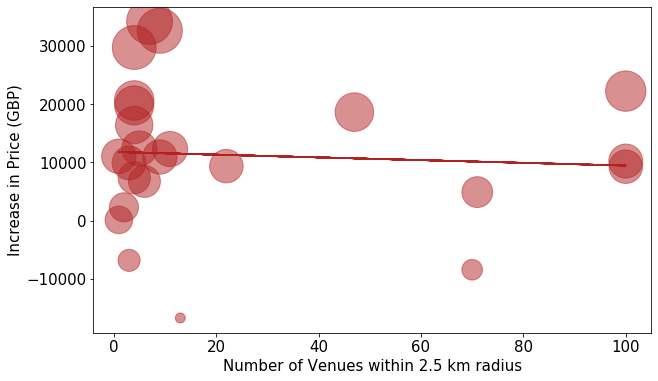

In [96]:
### type your answer here
norm_pricev = (scot_merged['PriceIncrease'] - scot_merged['PriceIncrease'].min()) / (scot_merged['PriceIncrease'].max() - scot_merged['PriceIncrease'].min())
x = scot_merged['VenueCounts']      # year on x-axis
y = scot_merged['PriceIncrease'].astype(float)     # total on y-axis
fit = np.polyfit(x, y, deg=1)


ax0 = scot_merged.plot(kind='scatter',
                   x = 'VenueCounts',
                   y = 'PriceIncrease',
                   alpha = 0.5,
                   color = 'firebrick',
                   s=norm_pricev.astype(float)*2000+100,
                   figsize = (10,6))

plt.plot(x, fit[0] * x + fit[1], color='firebrick') # recall that x is the Years
# plt.annotate('y={0:.0f} x + {1:.0f}'.format(fit[0], fit[1]), xy=(2000, 150000))

ax0.set_ylabel('Increase in Price (GBP)', fontsize = 15)
ax0.tick_params(axis="y", labelsize=15)
ax0.set_xlabel('Number of Venues within 2.5 km radius', fontsize = 15)
ax0.tick_params(axis="x", labelsize=15)
# ax0.set_title('Population vs. Total Value', fontsize = 15)
# ax0.legend(['Number of Sales'], loc='upper left', fontsize = 20)

plt.show()

### It can be seen that the Price is rather decreasingn for area with more venues from 2019 to 2020! 
### This could be caused by the decline in tourism performance during COVID-19 Pandemic

## As for the place for best investment?

#### For Cluster 0, The place has been packed with Hotel, Pub, Coffee places, stores, etc. Therefore It could be best not to invest in these type of business. However, It lacks on Bed and Breakfast place, or cheap sleeping place.

#### For Cluster 1, The areas are for the residential area with outdoor activity attractions. It could be worth investing in this area  for Grocery stores, or coffee place.

#### For Cluster 2, is the supporting areas for the touristy place. This could be the best place to expand business related to tourism  such as Hotel, cheap Hotel would be good, and cheap eating place. Food manufacturing place will also be good to be built in this areas since its shorter distance to the touristy place.